In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
from torchvision import transforms
from PIL import Image
import torch.nn.functional as F
from google.colab.patches import cv2_imshow
import cv2

In [ ]:
!pip install facenet-pytorch

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [ ]:
from facenet_pytorch import InceptionResnetV1

def make_age_model():
    model = InceptionResnetV1(classify=True, pretrained='vggface2', num_classes=1)
    in_dim = model.logits.in_features
    model.logits = nn.Linear(in_dim, 1)
    return model

model = make_age_model()

  0%|          | 0.00/107M [00:00<?, ?B/s]

In [ ]:
def load_age_model(model, path):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    checkpoint = torch.load(path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    return model

model_path = '/content/drive/MyDrive/models/age_model_checkpoint_epoch_10_loss_4.57.pth'
age_model = load_age_model(model, model_path)

In [ ]:
def age_predict(resize_image, model):
    image = cv2.cvtColor(resize_image, cv2.COLOR_BGR2RGB)
    image
    image = Image.fromarray(image)

    preprocess = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.6284, 0.4901, 0.4325], std=[0.1869, 0.1712, 0.1561]),
    ])
    image = preprocess(image).unsqueeze(0)  # 배치 차원 추가

    image = image.to(device)
    model = model.to(device)

    model.eval()

    with torch.no_grad():
        prediction = model(image)

    return prediction.item()

In [ ]:
import requests
from io import BytesIO


image_url = 'https://kpopping.com/documents/0f/1/2048/230304-ITZY-Twitter-Update-documents-2.jpeg?v=32813'
response = requests.get(image_url)

image_stream = BytesIO(response.content)
image_stream.seek(0)
file_bytes = np.asarray(bytearray(image_stream.read()), dtype=np.uint8)
image = cv2.imdecode(file_bytes, cv2.IMREAD_COLOR)

cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
image_url = 'https://kpopping.com/documents/0f/1/2048/230304-ITZY-Twitter-Update-documents-2.jpeg?v=32813'
response = requests.get(image_url)
image = Image.open(BytesIO(response.content))
image_np = np.array(image)

In [ ]:
!pip install mtcnn

In [ ]:
class Gender_Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3)
        self.bn1 = nn.BatchNorm2d(32)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3)
        self.bn2 = nn.BatchNorm2d(64)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3)
        self.bn3 = nn.BatchNorm2d(128)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=3)
        self.bn4 = nn.BatchNorm2d(256)
        self.conv5 = nn.Conv2d(256, 512, kernel_size=3)
        self.bn5 = nn.BatchNorm2d(512)

        self.pool = nn.MaxPool2d(kernel_size=3, stride=2)

        self.fc1 = nn.Linear(512 * 4 * 4, 512)
        self.dropout = nn.Dropout(0.25)
        self.fc2 = nn.Linear(512, 1)

    def forward(self, x):
        x = self.pool(F.relu(self.bn1(self.conv1(x))))
        x = self.pool(F.relu(self.bn2(self.conv2(x))))
        x = self.pool(F.relu(self.bn3(self.conv3(x))))
        x = self.pool(F.relu(self.bn4(self.conv4(x))))
        x = self.pool(F.relu(self.bn5(self.conv5(x))))

        x = x.view(-1, 512 * 4 * 4)
        x = F.relu(self.fc1(self.dropout(x)))
        x = self.fc2(x)
        x = x.squeeze()
        return x

gender_model = Gender_Net().to(device)

In [ ]:
def load_gender_model(model, path):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    checkpoint = torch.load(path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    return model

model_path = '/content/drive/MyDrive/models/gender_model_v3_checkpoint_epoch_19.pth'
gender_model = load_gender_model(gender_model, model_path)

In [ ]:
def gender_predict(resize_image, gender_model):
  # 검출된 얼굴 불러오기
  image = cv2.cvtColor(resize_image, cv2.COLOR_BGR2RGB)
  image
  image = Image.fromarray(image)

  # 전처리
  preprocess = transforms.Compose([
      transforms.Resize((224, 224)),  # 이미지를 모델에 맞는 크기로 리사이징
      transforms.ToTensor(),           # 이미지를 텐서로 변환
      transforms.Normalize((0.6284, 0.4901, 0.4325), (0.1869, 0.1712, 0.1561)),  # 이미지를 정규화
  ])

  # 이미지 전처리 및 배치 차원 추가
  input_tensor = preprocess(image)
  input_batch = input_tensor.unsqueeze(0)  # 배치 차원 추가

  # 이미지를 디바이스로 이동
  input_batch = input_batch.to(device)

  gender_model.eval()
  # 모델 예측
  with torch.no_grad():
      output = gender_model(input_batch)

  # 예측 결과 해석
  # print(torch.sigmoid(output))
  predicted_class = torch.sigmoid(output).item() # 모델의 출력을 확률로 변환
  gender = 'Male' if predicted_class < 0.5 else 'Female'  # 임계값을 기준으로 성별 분류
  print(f'Predicted Gender: {gender} (Probability: {predicted_class:.10f})')
  return gender

# gender_predict = gender_predict(face_img, gender_model)
# gender_predict(face_img, gender_model)

2/2 [==============================] - 0s 5ms/step
Predicted Gender: Female (Probability: 0.8159255385)
Female
19.313526153564453
Predicted Gender: Female (Probability: 0.9715733528)
Female
20.29201889038086
Predicted Gender: Female (Probability: 0.9476812482)
Female
21.897247314453125
Predicted Gender: Female (Probability: 0.9944820404)
Female
23.64818572998047
Predicted Gender: Female (Probability: 0.9949172735)
Female
23.080820083618164


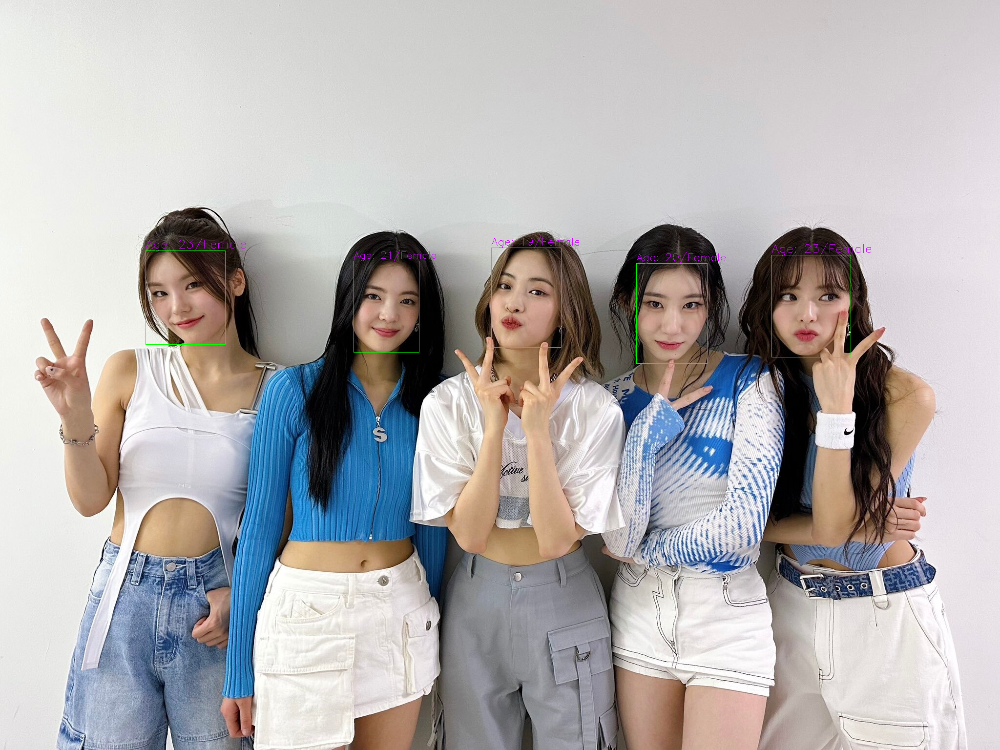

In [ ]:
from mtcnn import MTCNN

def result(image_path):
  img = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
  detector = MTCNN()
  detections = detector.detect_faces(img)

  origin_image = img.copy()
  min_conf = 0.9
  for face in detections:
      if face['confidence'] >= min_conf:
          x, y, w, h = face['box']
          # 얼굴 영역 잘라내기
          face_img = img[y : y+h, x : x+w]
          resized_face_img = cv2.resize(face_img, (224, 224))
          resized_face_img = cv2.cvtColor(resized_face_img, cv2.COLOR_RGB2BGR)

          # 나이 예측
          age = age_predict(resized_face_img, age_model)
          # 성별 예측
          gender = gender_predict(resized_face_img, gender_model)

          # 결과 출력
          cv2.rectangle(origin_image, (x,y), (x+w,y+h), (0,255,0), 1)

          print(gender)
          print(age)
          if gender == 'Male':
            cv2.putText(origin_image, f'Age: {int(age)}/{gender}', (x, y-5), cv2.FONT_HERSHEY_SIMPLEX, w*0.05, (0, 255, 255), 1)

          elif gender == 'Female':
            cv2.putText(origin_image, f'Age: {int(age)}/{gender}', (x, y-5), cv2.FONT_HERSHEY_SIMPLEX, w*0.05, (203, 12, 255), 1)

  cv2_imshow(cv2.cvtColor(origin_image, cv2.COLOR_BGR2RGB))


image_path = '/content/itzy2.jpeg'
result(image_path)

1/1 [==============================] - 0s 342ms/step
Predicted Gender: Female (Probability: 0.9927470088)
Female
19.921531677246094


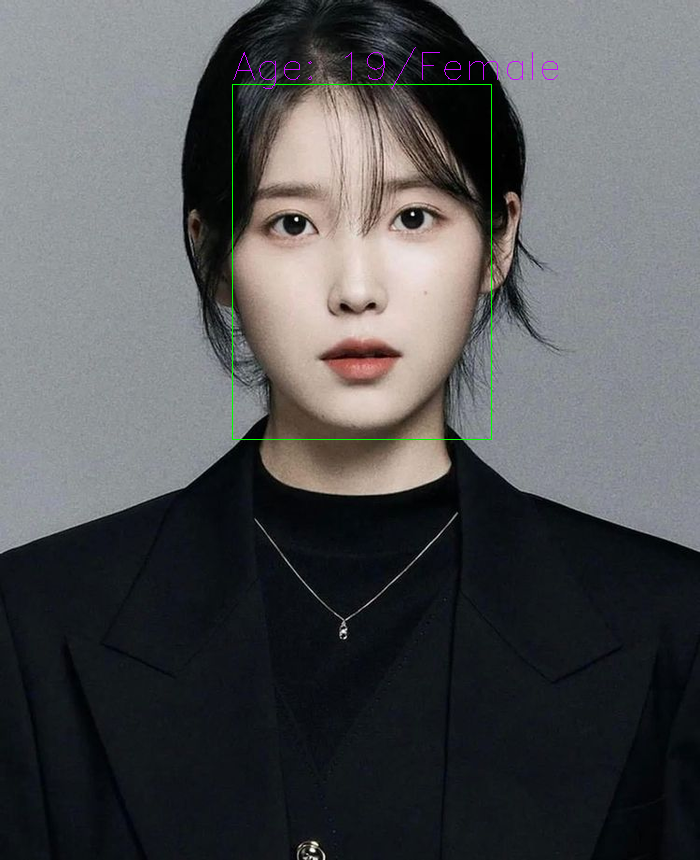

In [ ]:
def result(img, detections):

  origin_image = img.copy()
  min_conf = 0.9
  for face in detections:
      if face['confidence'] >= min_conf:
          x, y, w, h = face['box']
          # 얼굴 영역 잘라내기
          face_img = img[y : y+h, x : x+w]
          resized_face_img = cv2.resize(face_img, (224, 224))
          resized_face_img = cv2.cvtColor(resized_face_img, cv2.COLOR_RGB2BGR)

          # 나이 예측
          age = age_predict(resized_face_img, age_model)
          # 성별 예측
          gender = gender_predict(resized_face_img, gender_model)

          # 결과 출력
          cv2.rectangle(origin_image, (x,y), (x+w,y+h), (0,255,0), 1)

          print(gender)
          print(age)
          if gender == 'Male':
            cv2.putText(origin_image, f'Age: {int(age)}/{gender}', (x, y-5), cv2.FONT_HERSHEY_SIMPLEX, w*0.005, (0, 255, 255), 1)

          elif gender == 'Female':
            cv2.putText(origin_image, f'Age: {int(age)}/{gender}', (x, y-5), cv2.FONT_HERSHEY_SIMPLEX, w*0.005, (203, 12, 255), 1)

  cv2_imshow(cv2.cvtColor(origin_image, cv2.COLOR_BGR2RGB))
          # plt.axis('off')
          # plt.show()

image_path = '/content/iu.png'
img = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
detector = MTCNN()
detections = detector.detect_faces(img)

result(img, detections)

In [ ]:
image_path = '/content/student.jpg'
img = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
detector = MTCNN()
detections = detector.detect_faces(img)

Predicted Gender: Female (Probability: 0.7426261902)
Female
28.21478843688965
Predicted Gender: Female (Probability: 0.9461476803)
Female
18.16529083251953
Predicted Gender: Male (Probability: 0.0076589971)
Male
39.97480010986328
Predicted Gender: Male (Probability: 0.3969893157)
Male
29.953916549682617


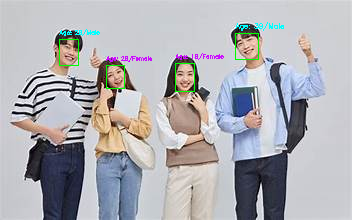

In [ ]:
result(img, detections)

In [ ]:
image_path = '/content/korea.jpg'
img = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
detector = MTCNN()
detections = detector.detect_faces(img)

2/2 [==============================] - 1s 194ms/step


Predicted Gender: Male (Probability: 0.0322877578)
Male
20.52715301513672
Predicted Gender: Male (Probability: 0.0440589823)
Male
27.538726806640625
Predicted Gender: Male (Probability: 0.0001623407)
Male
19.421058654785156
Predicted Gender: Male (Probability: 0.0001034099)
Male
21.643707275390625
Predicted Gender: Male (Probability: 0.0000045142)
Male
28.97987174987793
Predicted Gender: Male (Probability: 0.0027847718)
Male
24.32285499572754
Predicted Gender: Male (Probability: 0.2298268974)
Male
18.300765991210938
Predicted Gender: Male (Probability: 0.0027999030)
Male
25.459035873413086
Predicted Gender: Male (Probability: 0.0002836399)
Male
17.4556827545166
Predicted Gender: Male (Probability: 0.3005674183)
Male
28.426748275756836
Predicted Gender: Male (Probability: 0.0000561346)
Male
18.66010856628418


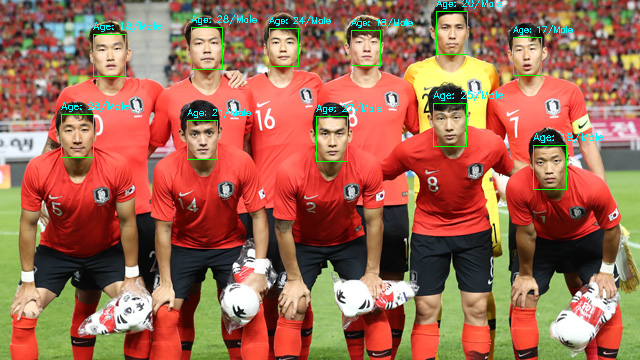

In [ ]:
result(img, detections)

5/5 [==============================] - 0s 2ms/step


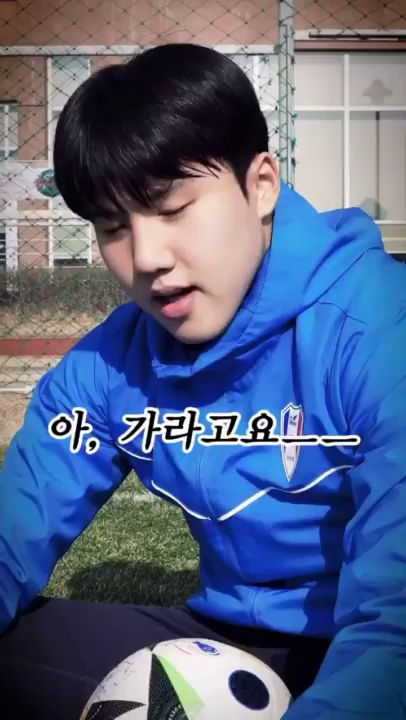

1/1 [==============================] - 0s 130ms/step


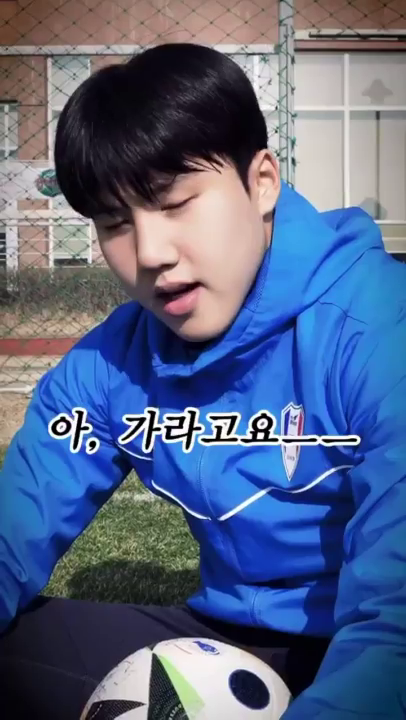

1/1 [==============================] - 0s 125ms/step


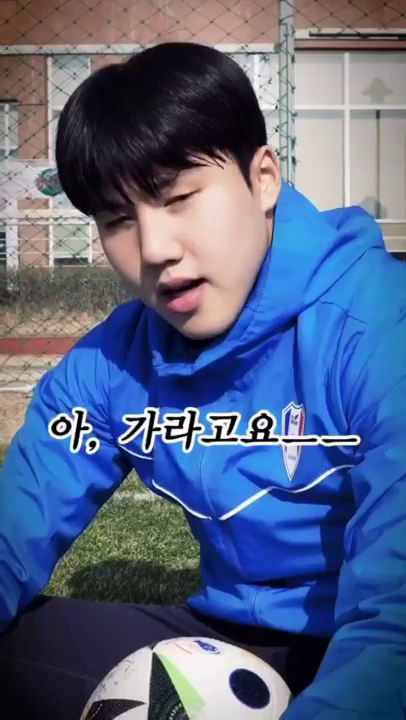

1/1 [==============================] - 0s 141ms/step


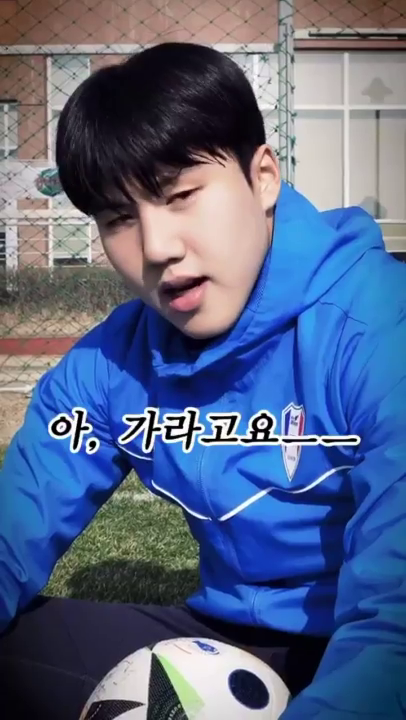

1/1 [==============================] - 0s 126ms/step


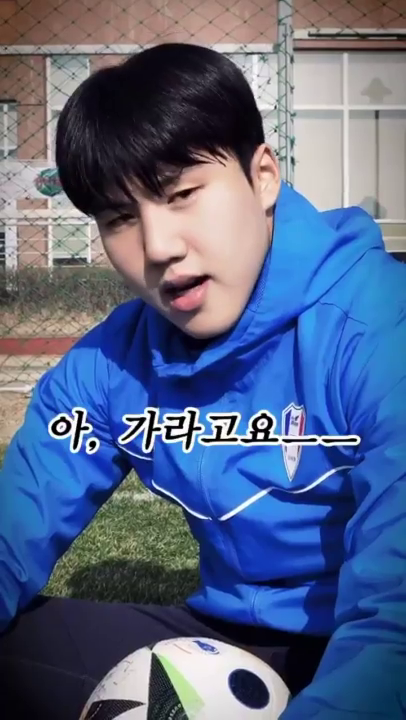

1/1 [==============================] - 0s 136ms/step


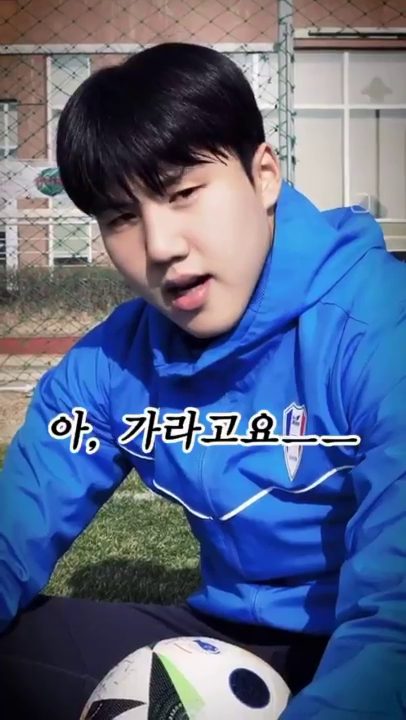

1/1 [==============================] - 0s 129ms/step


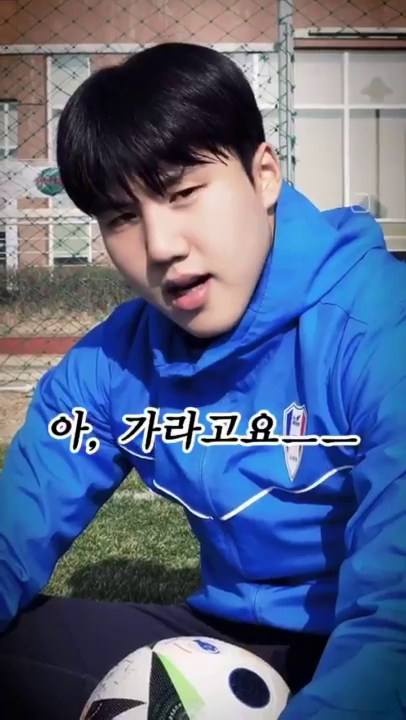

1/1 [==============================] - 0s 156ms/step


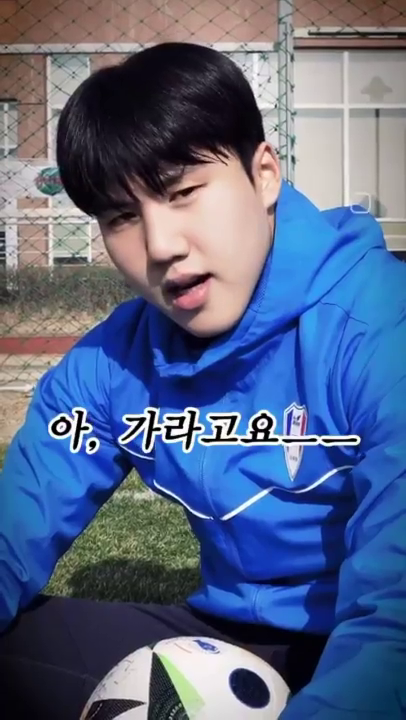

1/1 [==============================] - 0s 138ms/step


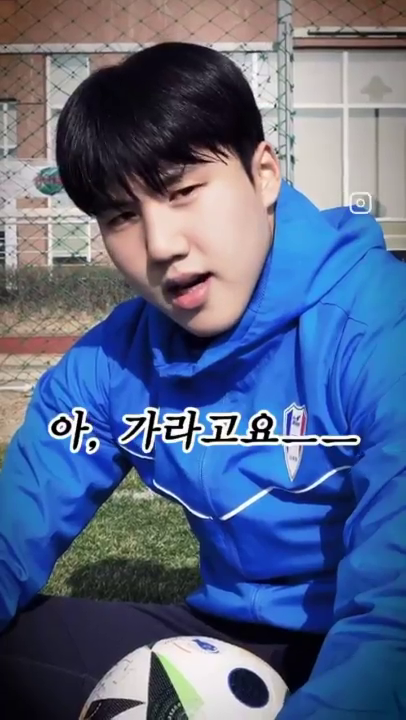

1/1 [==============================] - 0s 141ms/step


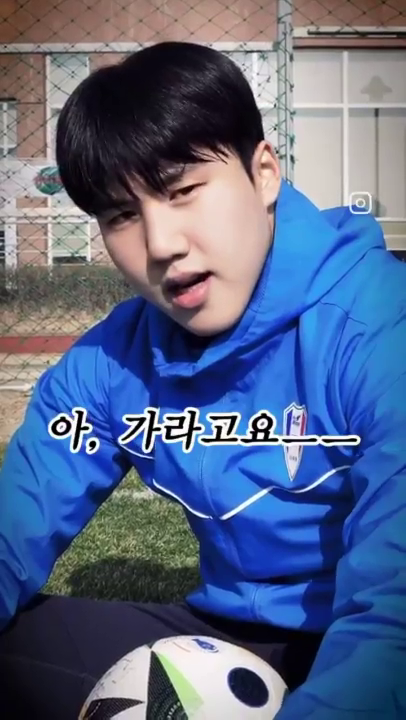

1/1 [==============================] - 0s 134ms/step
Predicted Gender: Male (Probability: 0.1901887357)
Male
16.7014217376709


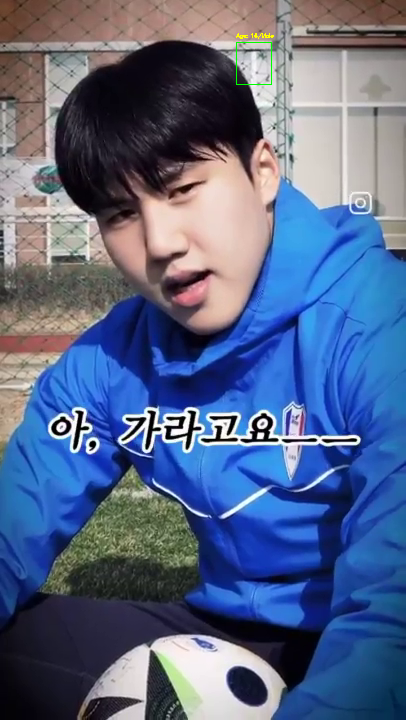

1/1 [==============================] - 0s 133ms/step


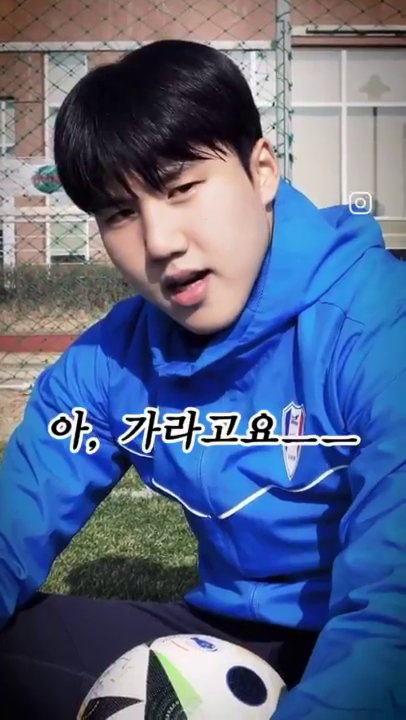

1/1 [==============================] - 0s 138ms/step
Predicted Gender: Male (Probability: 0.0567165613)
Male
19.64836311340332


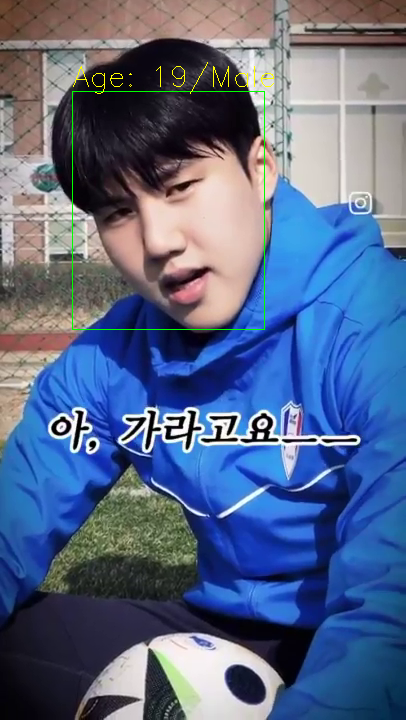

1/1 [==============================] - 0s 146ms/step
Predicted Gender: Male (Probability: 0.0746311843)
Male
19.896745681762695


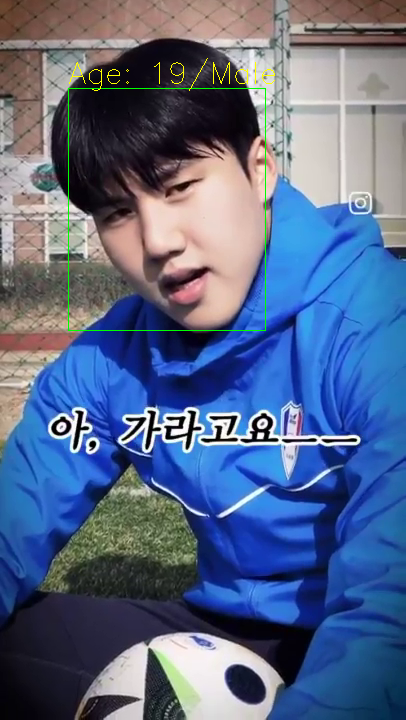

1/1 [==============================] - 0s 131ms/step
Predicted Gender: Male (Probability: 0.0757396966)
Male
19.82530403137207


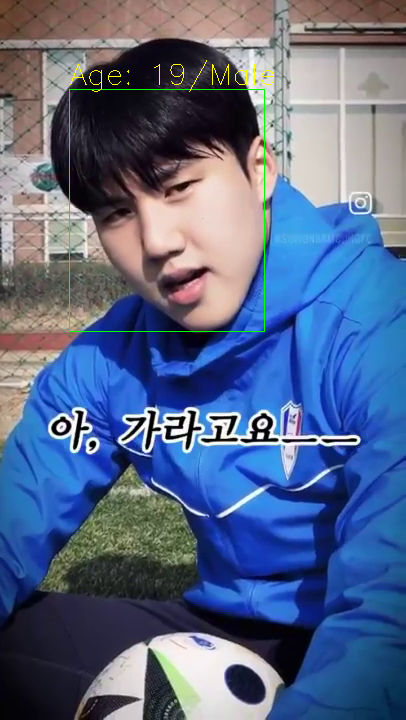

1/1 [==============================] - 0s 156ms/step
Predicted Gender: Male (Probability: 0.0783158392)
Male
17.689088821411133


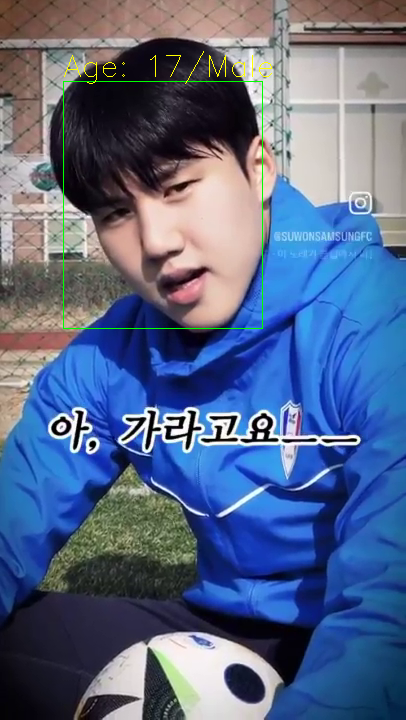

1/1 [==============================] - 0s 131ms/step
Predicted Gender: Male (Probability: 0.0706006959)
Male
17.909292221069336


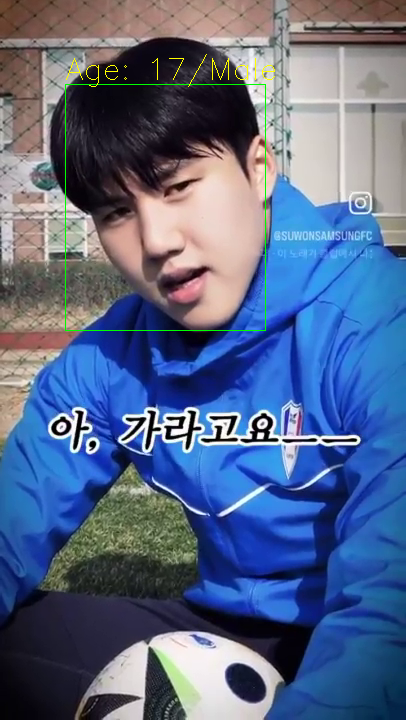

1/1 [==============================] - 0s 132ms/step


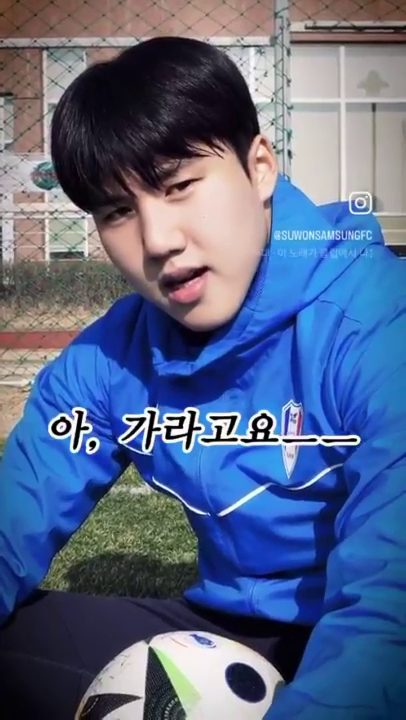

1/1 [==============================] - 0s 134ms/step
Predicted Gender: Male (Probability: 0.0588069484)
Male
17.057287216186523


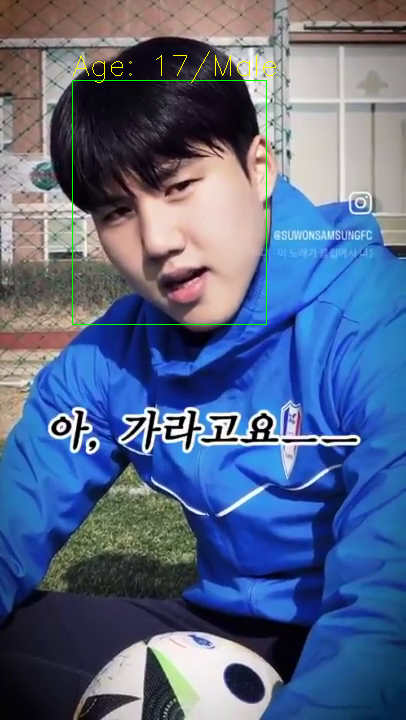

1/1 [==============================] - 0s 141ms/step
Predicted Gender: Male (Probability: 0.0681686103)
Male
19.199182510375977


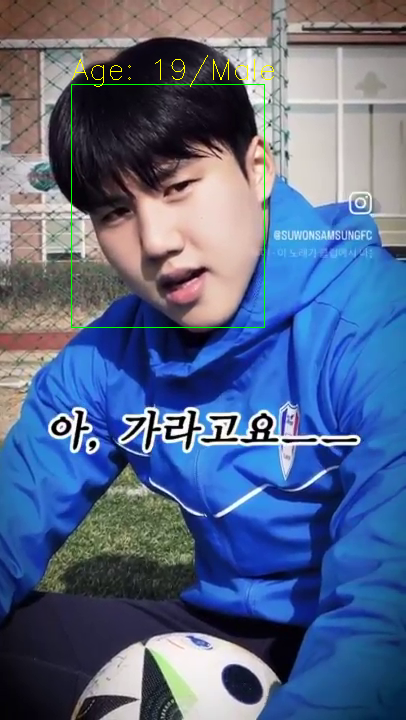

1/1 [==============================] - 0s 138ms/step


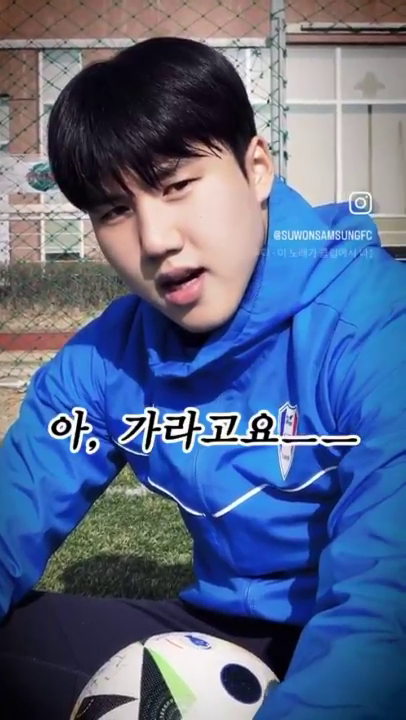

1/1 [==============================] - 0s 130ms/step


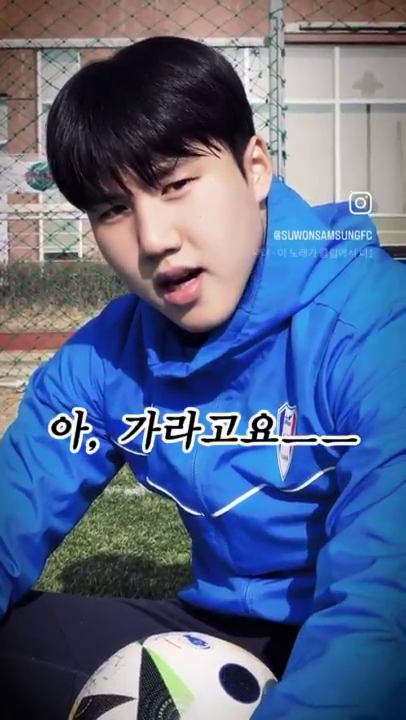

1/1 [==============================] - 0s 137ms/step
Predicted Gender: Male (Probability: 0.0489944778)
Male
19.119287490844727


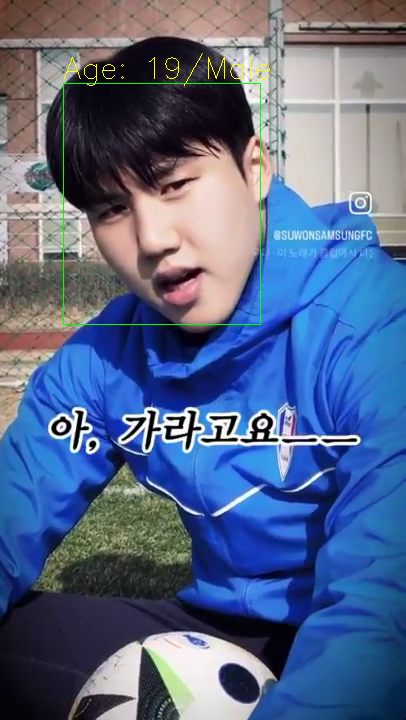

1/1 [==============================] - 0s 130ms/step
Predicted Gender: Male (Probability: 0.0276130587)
Male
22.151945114135742


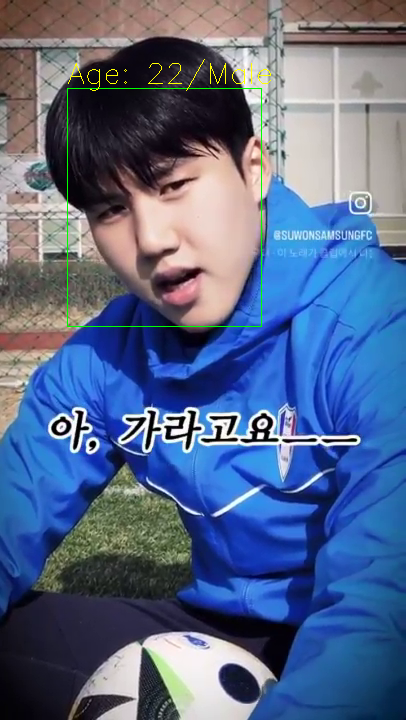

1/1 [==============================] - 0s 130ms/step


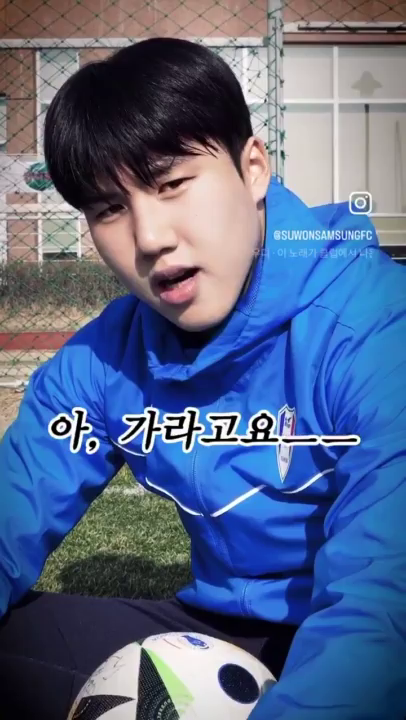

1/1 [==============================] - 0s 187ms/step


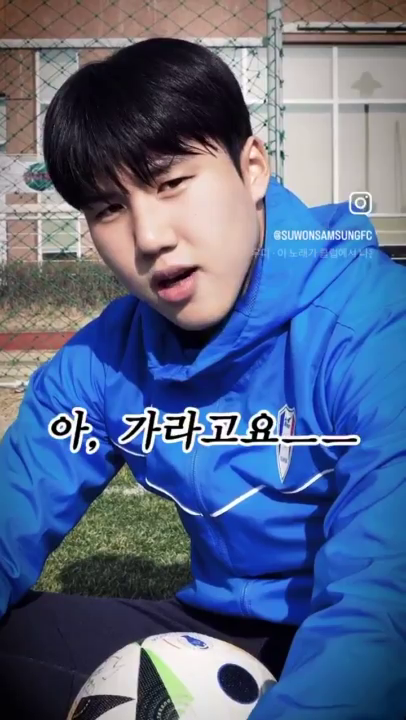

1/1 [==============================] - 0s 151ms/step


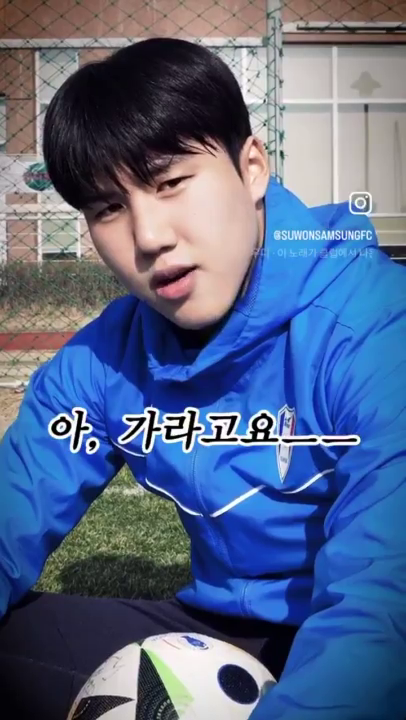

5/5 [==============================] - 0s 52ms/step


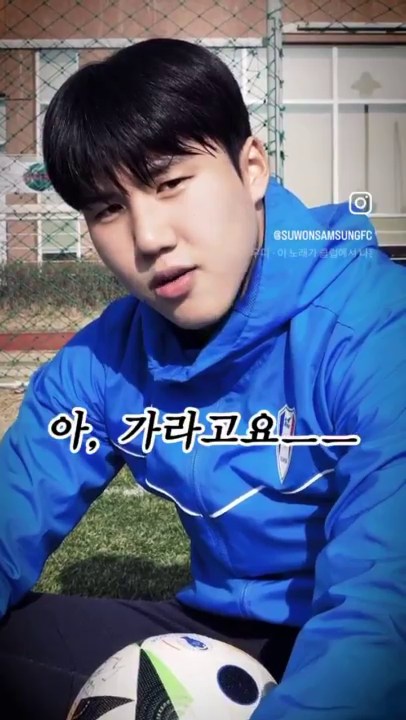

1/1 [==============================] - 0s 138ms/step
Predicted Gender: Male (Probability: 0.0454884097)
Male
19.939422607421875


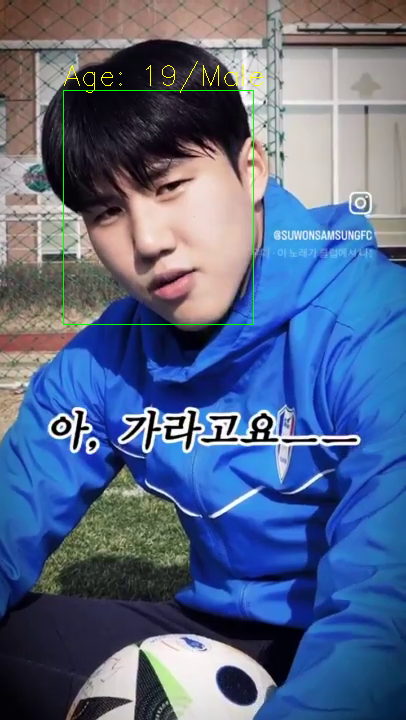

1/1 [==============================] - 0s 322ms/step
Predicted Gender: Male (Probability: 0.0415904000)
Male
19.77779197692871


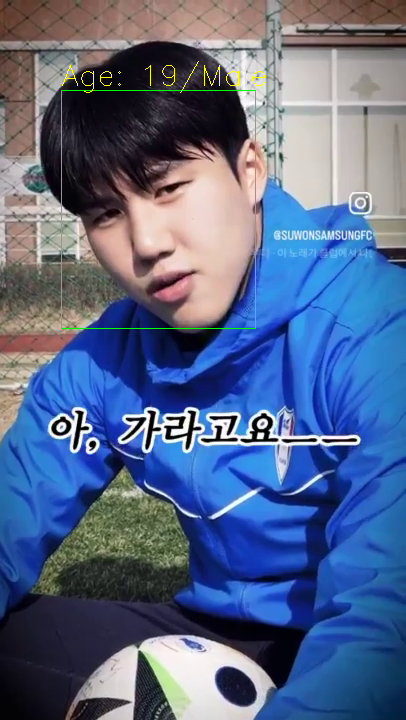

1/1 [==============================] - 0s 342ms/step
Predicted Gender: Male (Probability: 0.0871595591)
Male
20.294872283935547


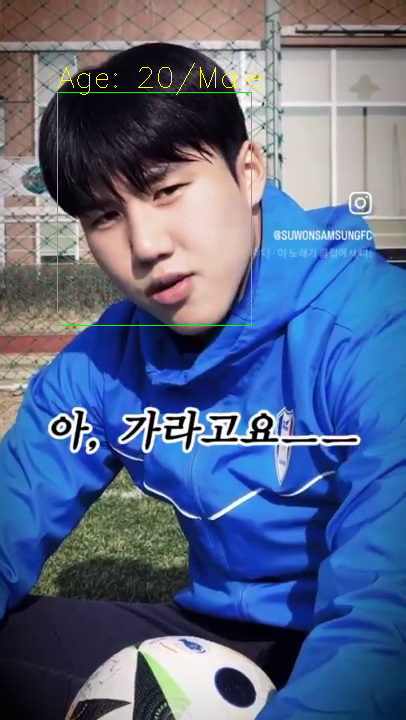

1/1 [==============================] - 0s 141ms/step
Predicted Gender: Male (Probability: 0.0453666002)
Male
19.89658546447754


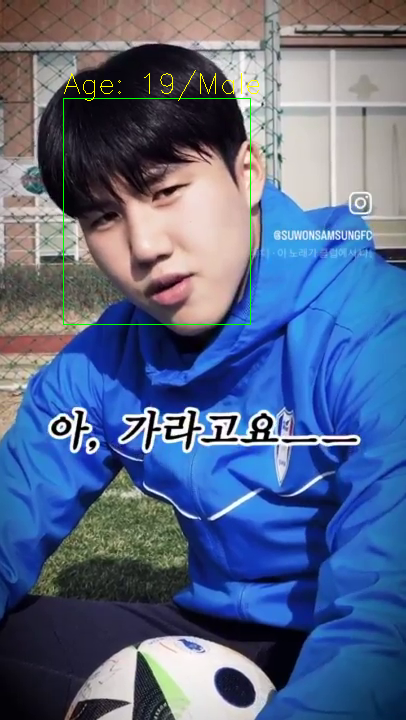

1/1 [==============================] - 0s 146ms/step
Predicted Gender: Male (Probability: 0.0922785625)
Male
20.43724822998047


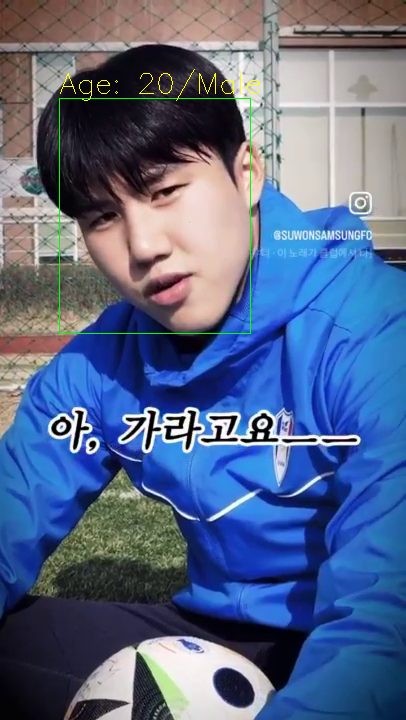

1/1 [==============================] - 0s 140ms/step
Predicted Gender: Male (Probability: 0.0459624007)
Male
22.430885314941406


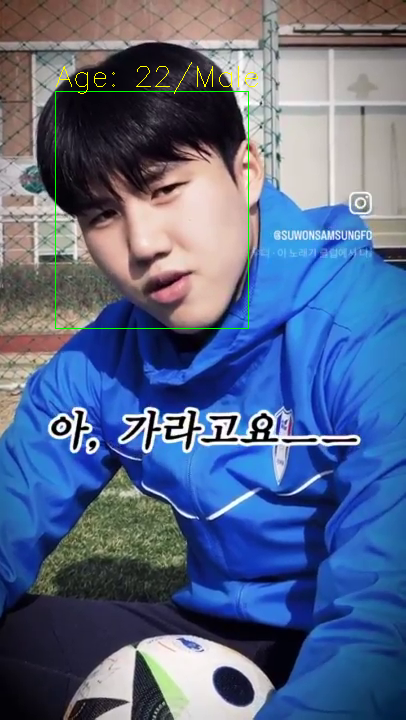

1/1 [==============================] - 0s 142ms/step
Predicted Gender: Male (Probability: 0.0836883709)
Male
24.366134643554688


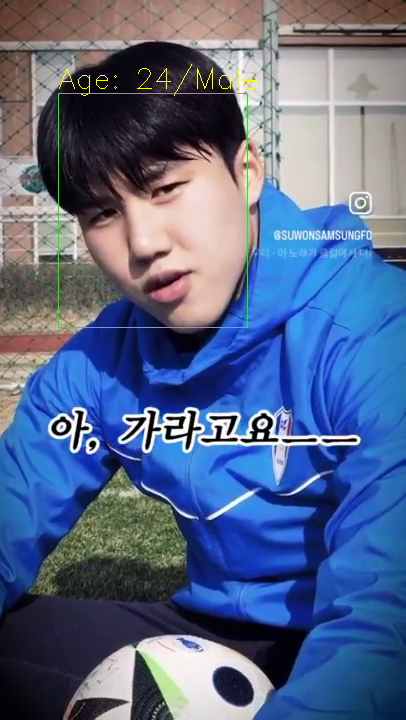

1/1 [==============================] - 0s 135ms/step


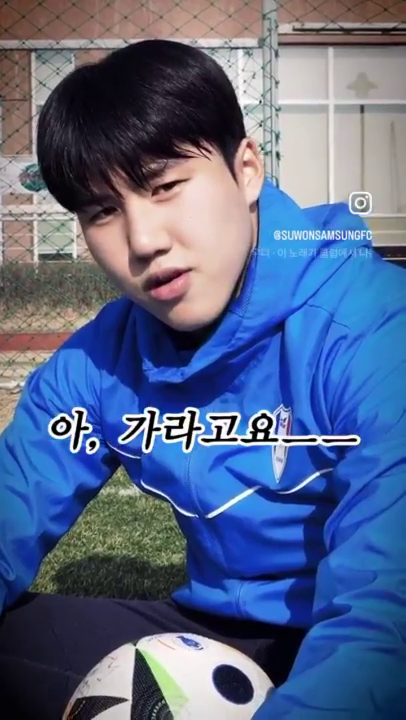

1/1 [==============================] - 0s 132ms/step


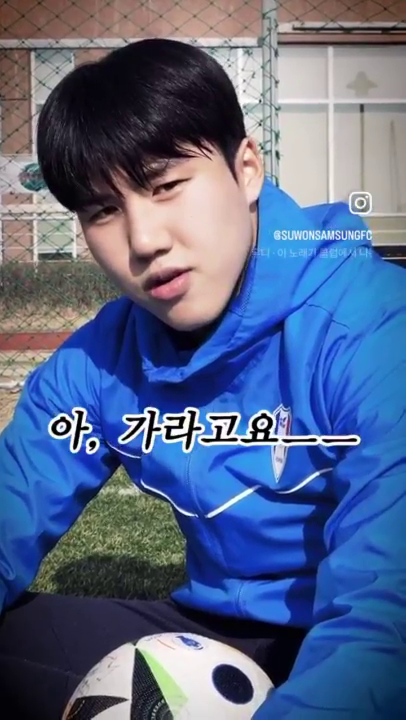

1/1 [==============================] - 0s 139ms/step


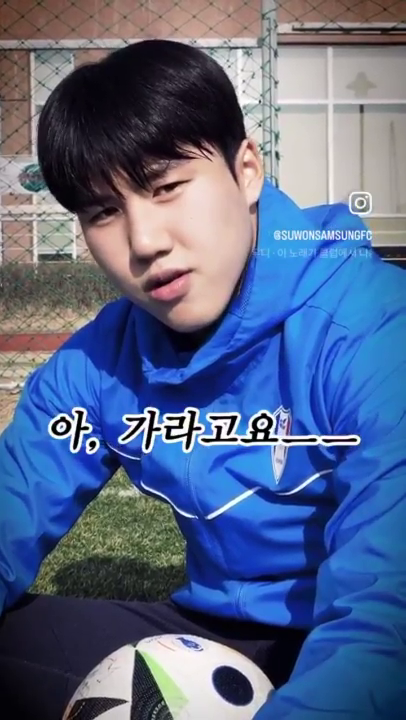

1/1 [==============================] - 0s 139ms/step
Predicted Gender: Male (Probability: 0.0561182499)
Male
23.95170021057129


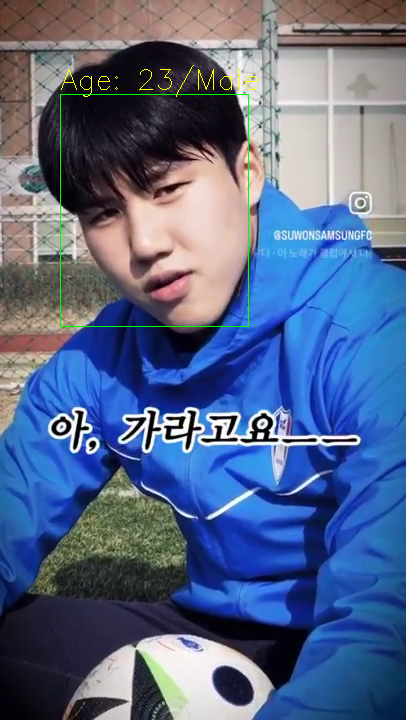

1/1 [==============================] - 0s 131ms/step
Predicted Gender: Male (Probability: 0.0528295077)
Male
20.812654495239258
Predicted Gender: Male (Probability: 0.0103017204)
Male
17.904586791992188


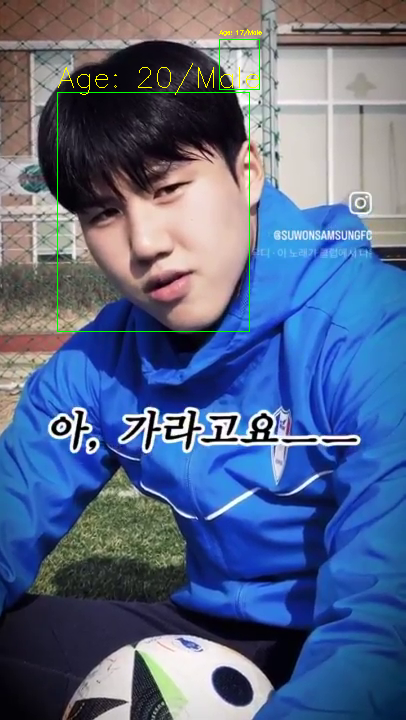

1/1 [==============================] - 0s 137ms/step
Predicted Gender: Male (Probability: 0.0483487472)
Male
21.643396377563477


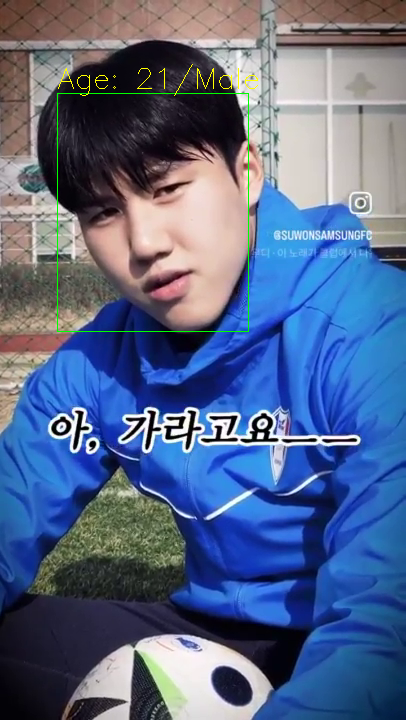

1/1 [==============================] - 0s 142ms/step
Predicted Gender: Male (Probability: 0.0402366556)
Male
21.343767166137695


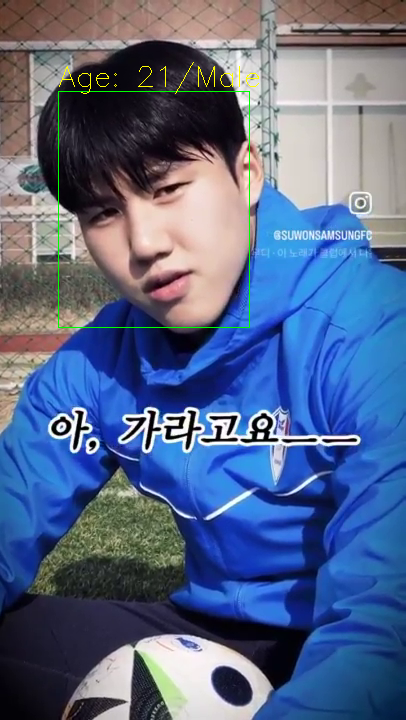

1/1 [==============================] - 0s 20ms/step


KeyboardInterrupt: 

In [ ]:
from mtcnn import MTCNN

video = cv2.VideoCapture('/content/video.mp4')

#while문을 사용하여 특정 조건이 만족될 때까지 계속 실행

while video.isOpened():
    ret, frame = video.read()
    if not ret:
        break

    detection = MTCNN()
    detections = detection.detect_faces(frame)

    min_conf = 0.9
    for face in detections:
        if face['confidence'] >= min_conf:
            x, y, w, h = face['box']
            # 얼굴 영역 잘라내기
            face_img = frame[y : y+h, x : x+w]
            resized_face_img = cv2.resize(face_img, (224, 224))
            resized_face_img = cv2.cvtColor(resized_face_img, cv2.COLOR_RGB2BGR)

            # 나이 예측
            age = age_predict(resized_face_img, age_model)
            # 성별 예측
            gender = gender_predict(resized_face_img, gender_model)

            # 결과 출력
            cv2.rectangle(frame, (x,y), (x+w,y+h), (0,255,0), 1)

            print(gender)
            print(age)
            if gender == 'Male':
              cv2.putText(frame, f'Age: {int(age)}/{gender}', (x, y-5), cv2.FONT_HERSHEY_SIMPLEX, w*0.005, (0, 255, 255), 1)

            elif gender == 'Female':
              cv2.putText(frame, f'Age: {int(age)}/{gender}', (x, y-5), cv2.FONT_HERSHEY_SIMPLEX, w*0.005, (203, 12, 255), 1)

    # cv2_imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    cv2_imshow(frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

video.release()
cv2.destroyAllWindows()